# Deep Convolutional Generative Adversarial Network (DCGAN) Tutorial



Adapted from Arthur Juliani, see his post here [Medium post](https://medium.com/p/54deab2fce39) on his implementation of DCGAN.

In the cifar-10 implementation, currently the discriminator is overpowering the generator. See possible solutions:
https://colab.research.google.com/drive/1BUIF2VI0mEWN5yheY5NxAB6EtLBBiw4K#scrollTo=YpPWbXlhkkuq
https://github.com/fzliu/tf-dcgan/blob/master/models.py

In [0]:
#Import the libraries we will need.
import tensorflow as tf
import numpy as np
from tensorflow.examples.tutorials.mnist import input_data
import matplotlib.pyplot as plt
import tensorflow.contrib.slim as slim
import os
import scipy.misc
import scipy

We will be using the MNIST dataset. input_data is a library that downloads the dataset and uzips it automatically.

In [116]:
from PIL import Image
import tarfile

# Download dataset
url = "https://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz"
import os
import urllib
from urllib.request import urlretrieve
def reporthook(a,b,c):
    print("\rdownloading: %5.1f%%"%(a*b*100.0/c), end="")
tar_gz = "cifar-10-python.tar.gz"
if not os.path.isfile(tar_gz):
        print('Downloading data from %s' % url)
        urlretrieve(url, tar_gz, reporthook=reporthook)

import pickle
train_X=[]
train_y=[]
tar_gz = "cifar-10-python.tar.gz"
with tarfile.open(tar_gz) as tarf:
    for i in range(1, 6):
        dataset = "cifar-10-batches-py/data_batch_%d"%i
        print("load",dataset)
        with tarf.extractfile(dataset) as f:
            result = pickle.load(f, encoding='latin1')
        train_X.extend(result['data'].reshape(-1,32,32,3)/255*2-1)
        train_y.extend(result['labels'])
    train_X=np.float32(train_X)
    train_y=np.int32(train_y)
    dataset = "cifar-10-batches-py/test_batch"
    print("load",dataset)
    with tarf.extractfile(dataset) as f:
        result = pickle.load(f, encoding='latin1')
        test_X=np.float32(result['data'].reshape(-1,32,32,3)/255*2-1)
        test_y=np.int32(result['labels'])


load cifar-10-batches-py/data_batch_1
load cifar-10-batches-py/data_batch_2
load cifar-10-batches-py/data_batch_3
load cifar-10-batches-py/data_batch_4
load cifar-10-batches-py/data_batch_5
load cifar-10-batches-py/test_batch


In [117]:
test_X.shape

(10000, 32, 32, 3)

In [118]:
train_X = np.concatenate([train_X, test_X])
train_X = np.concatenate([train_X[:,:,:,::-1], train_X])
train_X.shape

(120000, 32, 32, 3)

(20, 32, 32, 3)
(20, 32, 32, 3)
(32, 640, 3)


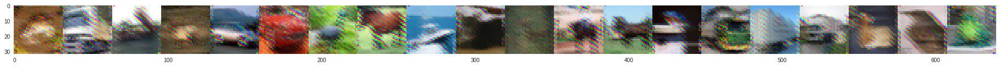

[6 9 9 4 1 1 2 7 8 3 4 7 7 2 9 9 9 3 2 6]
['frog' 'truck' 'truck' 'deer' 'car' 'car' 'bird' 'horse' 'boat' 'cat'
 'deer' 'horse' 'horse' 'bird' 'truck' 'truck' 'truck' 'cat' 'bird' 'frog']


In [119]:
def showX(X, rows=1):
    assert X.shape[0]%rows == 0
    int_X = ((X+1)/2).clip(0,1)
    print(int_X.shape)
    # N*3072 -> N*3*32*32 -> 32 * 32N * 3
    int_X = np.moveaxis(int_X.reshape(-1,3,32,32), 1, 3)
    print(int_X.shape)
    int_X = int_X.reshape(rows, -1, 32, 32,3).swapaxes(1,2).reshape(rows*32,-1, 3)
    print(int_X.shape)
    plt.figure(figsize=(32,32))
    ax = plt.gca()
    ax.grid(False)
    plt.imshow(int_X, origin="upper", cmap=None)
    plt.show()
showX(train_X[:20])
print(train_y[:20])
name_array = np.array("airplane car bird cat deer dog frog horse boat truck".split(' '))
print(name_array[train_y[:20]])

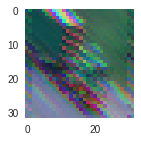

In [120]:
viz = np.moveaxis(train_X.reshape(-1,3,32,32), 1, 3)
plt.figure(figsize=(2,2))
ax = plt.gca()
ax.grid(False)
plt.imshow((viz[50,:,:,:]+1)*0.5, origin="upper", cmap=None)
plt.show()

### Helper Functions

In [0]:
#This function performns a leaky relu activation, which is needed for the discriminator network.
def lrelu(x, leak=0.2, name="lrelu"):
     with tf.variable_scope(name):
         f1 = 0.5 * (1 + leak)
         f2 = 0.5 * (1 - leak)
         return f1 * x + f2 * abs(x)
      
def lrelug(x, leak=0.5, name="lrelu"):
     with tf.variable_scope(name):
         f1 = 0.5 * (1 + leak)
         f2 = 0.5 * (1 - leak)
         return f1 * x + f2 * abs(x)
    
#The below functions are taken from carpdem20's implementation https://github.com/carpedm20/DCGAN-tensorflow
#They allow for saving sample images from the generator to follow progress
#def save_images(images, size, image_path):
#    return imsave(inverse_transform(images), size, image_path)

#def imsave(images, size, path):
#    return scipy.misc.imsave(path, merge(images, size))

def inverse_transform(images):
    return (images+1.)/2.

def merge(images, size):
    h, w = images.shape[1], images.shape[2]
    img = np.zeros((h * size[0], w * size[1]))

    for idx, image in enumerate(images):
        i = idx % size[1]
        j = idx // size[1]
        img[j*h:j*h+h, i*w:i*w+w] = image

    return img

## Defining the Adversarial Networks

### Generator Network

The generator takes a vector of random numbers and transforms it into a 32x32 image. Each layer in the network involves a strided  transpose convolution, batch normalization, and rectified nonlinearity. Tensorflow's slim library allows us to easily define each of these layers.

In [0]:
def generator(z):
    
    zP = slim.fully_connected(z,4*4*256,normalizer_fn=slim.batch_norm,\
        activation_fn=tf.nn.relu,scope='g_project',weights_initializer=initializer)
    zCon = tf.reshape(zP,[-1,4,4,256])
    
    gen1 = slim.convolution2d_transpose(\
        zCon,num_outputs=128,kernel_size=[5,5],stride=[2,2],\
        padding="SAME",normalizer_fn=slim.batch_norm,\
        activation_fn=tf.nn.relu,scope='g_conv1', weights_initializer=initializer)
    
    gen2 = slim.convolution2d_transpose(\
        gen1,num_outputs=64,kernel_size=[5,5],stride=[2,2],\
        padding="SAME",normalizer_fn=slim.batch_norm,\
        activation_fn=tf.nn.relu,scope='g_conv2', weights_initializer=initializer)
    
    gen3 = slim.convolution2d_transpose(\
        gen2,num_outputs=32,kernel_size=[5,5],stride=[2,2],\
        padding="SAME",normalizer_fn=slim.batch_norm,\
        activation_fn=tf.nn.relu,scope='g_conv3', weights_initializer=initializer)
    
    g_out = slim.convolution2d_transpose(\
        gen3,num_outputs=3,kernel_size=[32,32],padding="SAME",\
        biases_initializer=None,activation_fn=lrelug,\
        scope='g_out', weights_initializer=initializer)
    
    return g_out

### Discriminator Network
The discriminator network takes as input a 32x32 image and transforms it into a single valued probability of being generated from real-world data. Again we use tf.slim to define the convolutional layers, batch normalization, and weight initialization.

In [0]:
def discriminator(bottom, reuse=False):
    
    dis1 = slim.convolution2d(bottom,32,[4,4],stride=[2,2],padding="SAME",\
        biases_initializer=None,activation_fn=lrelu,\
        reuse=reuse,scope='d_conv1',weights_initializer=initializer)
    
    dis2 = slim.convolution2d(dis1,64,[4,4],stride=[2,2],padding="SAME",\
        normalizer_fn=slim.batch_norm,activation_fn=lrelu,\
        reuse=reuse,scope='d_conv2', weights_initializer=initializer)
    
    dis3 = slim.convolution2d(dis2,128,[4,4],stride=[2,2],padding="SAME",\
        normalizer_fn=slim.batch_norm,activation_fn=lrelu,\
        reuse=reuse,scope='d_conv3',weights_initializer=initializer)
    
    d_out = slim.fully_connected(slim.flatten(dis3),1,activation_fn=tf.nn.sigmoid,\
        reuse=reuse,scope='d_out', weights_initializer=initializer)
    
    return d_out

### Connecting them together

In [124]:
tf.reset_default_graph()

z_size = 100 #Size of z vector used for generator.

#This initializaer is used to initialize all the weights of the network.
initializer = tf.truncated_normal_initializer(stddev=0.02)

#These two placeholders are used for input into the generator and discriminator, respectively.
z_in = tf.placeholder(shape=[None,z_size],dtype=tf.float32) #Random vector
real_in = tf.placeholder(shape=[None,32,32,3],dtype=tf.float32) #Real images

Gz = generator(z_in) #Generates images from random z vectors
Dx = discriminator(real_in) #Produces probabilities for real images
print(Gz.shape)
Dg = discriminator(Gz,reuse=True) #Produces probabilities for generator images

#These functions together define the optimization objective of the GAN.
d_loss = -tf.reduce_mean(tf.log(Dx) + tf.log(1.-Dg)) #This optimizes the discriminator.
g_loss = -tf.reduce_mean(tf.log(Dg)) #This optimizes the generator.

tvars = tf.trainable_variables()

#The below code is responsible for applying gradient descent to update the GAN.
trainerD = tf.train.AdamOptimizer(learning_rate=0.0002,beta1=0.5)
trainerG = tf.train.AdamOptimizer(learning_rate=0.0002,beta1=0.5)
d_grads = trainerD.compute_gradients(d_loss,tvars[9:]) #Only update the weights for the discriminator network.
g_grads = trainerG.compute_gradients(g_loss,tvars[0:9]) #Only update the weights for the generator network.

update_D = trainerD.apply_gradients(d_grads)
update_G = trainerG.apply_gradients(g_grads)

(?, 32, 32, 3)


## Training the network
Now that we have fully defined our network, it is time to train it!

0 (128, 32, 32, 3) Gen Loss: 0.09251088 Disc Loss: 1.711706


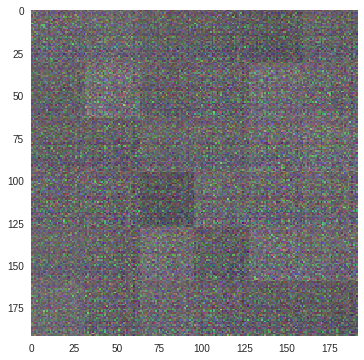

100 (128, 32, 32, 3) Gen Loss: 0.6324955 Disc Loss: 1.3792325


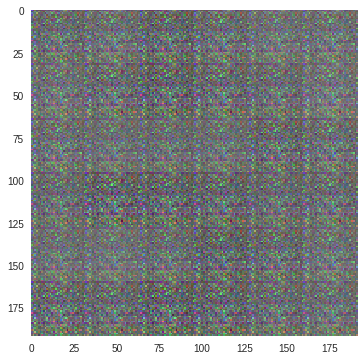

200 (128, 32, 32, 3) Gen Loss: 0.705323 Disc Loss: 1.6583232


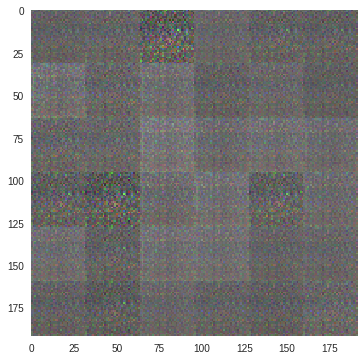

300 (128, 32, 32, 3) Gen Loss: 0.66253567 Disc Loss: 1.5105608


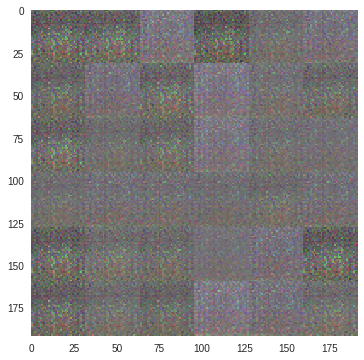

400 (128, 32, 32, 3) Gen Loss: 0.72020465 Disc Loss: 1.3857448


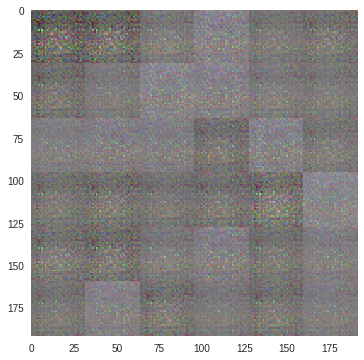

500 (128, 32, 32, 3) Gen Loss: 0.69668835 Disc Loss: 1.4428959


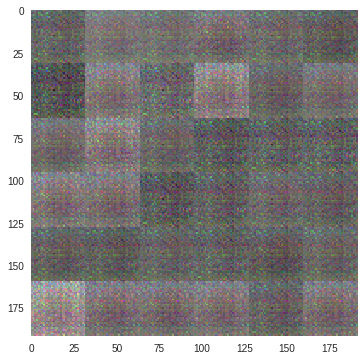

600 (128, 32, 32, 3) Gen Loss: 0.6466902 Disc Loss: 1.4641094


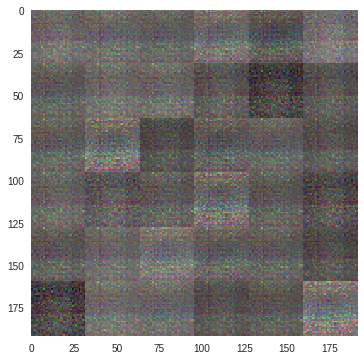

700 (128, 32, 32, 3) Gen Loss: 0.67970675 Disc Loss: 1.400485


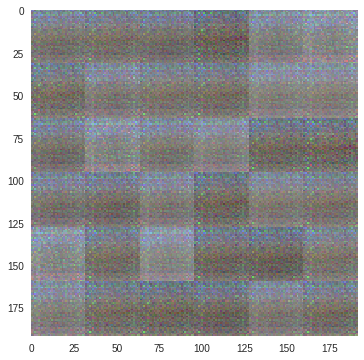

800 (128, 32, 32, 3) Gen Loss: 0.7073127 Disc Loss: 1.4013065


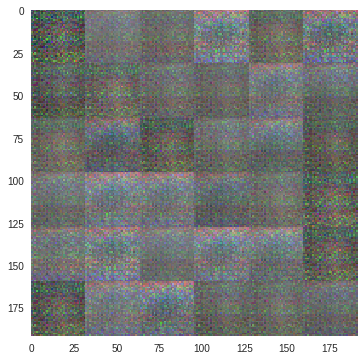

900 (128, 32, 32, 3) Gen Loss: 0.66458756 Disc Loss: 1.4222788


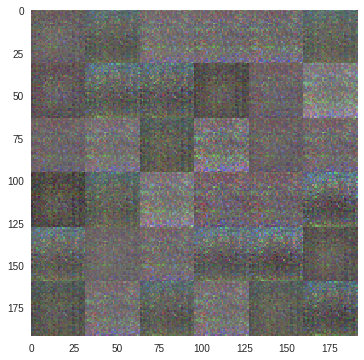

0 (128, 32, 32, 3) Gen Loss: 0.6678425 Disc Loss: 1.4255595


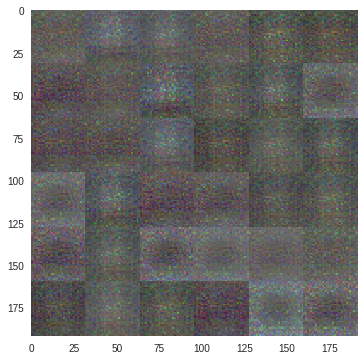

100 (128, 32, 32, 3) Gen Loss: 0.6808709 Disc Loss: 1.3992865


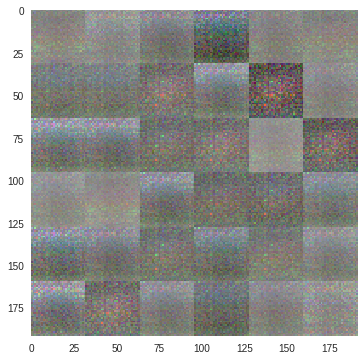

200 (128, 32, 32, 3) Gen Loss: 0.70138884 Disc Loss: 1.3986597


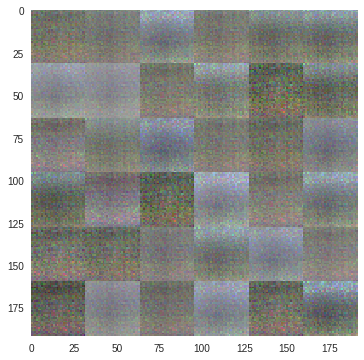

300 (128, 32, 32, 3) Gen Loss: 0.6947407 Disc Loss: 1.411871


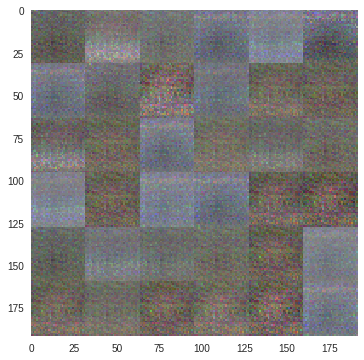

400 (128, 32, 32, 3) Gen Loss: 0.68065876 Disc Loss: 1.4222935


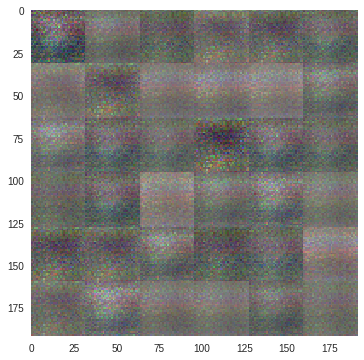

500 (128, 32, 32, 3) Gen Loss: 0.7027507 Disc Loss: 1.3893373


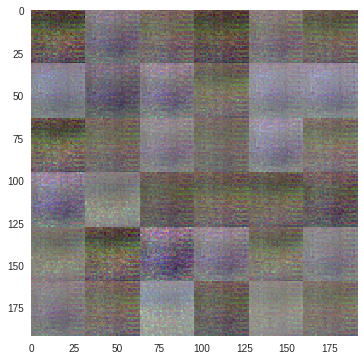

600 (128, 32, 32, 3) Gen Loss: 0.6846787 Disc Loss: 1.4056795


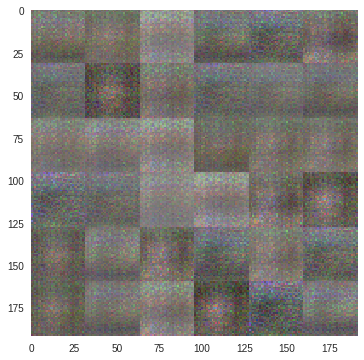

700 (128, 32, 32, 3) Gen Loss: 0.71792734 Disc Loss: 1.3989527


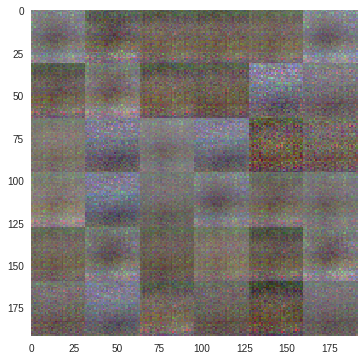

800 (128, 32, 32, 3) Gen Loss: 0.6959876 Disc Loss: 1.418294


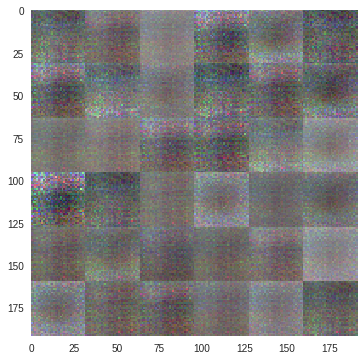

900 (128, 32, 32, 3) Gen Loss: 0.6954022 Disc Loss: 1.3995496


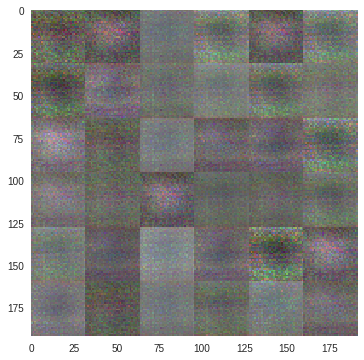

0 (128, 32, 32, 3) Gen Loss: 0.6891774 Disc Loss: 1.4015293


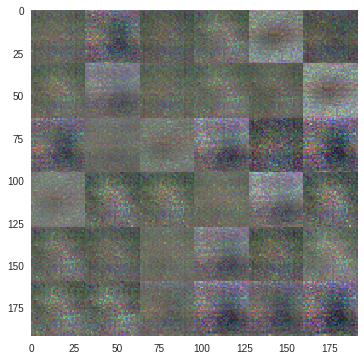

100 (128, 32, 32, 3) Gen Loss: 0.6831755 Disc Loss: 1.4159606


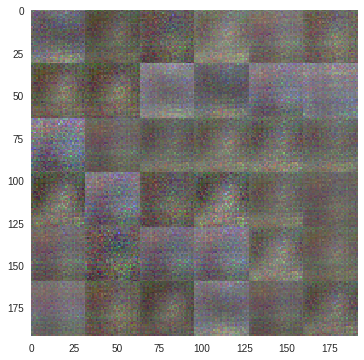

200 (128, 32, 32, 3) Gen Loss: 0.69083315 Disc Loss: 1.4006664


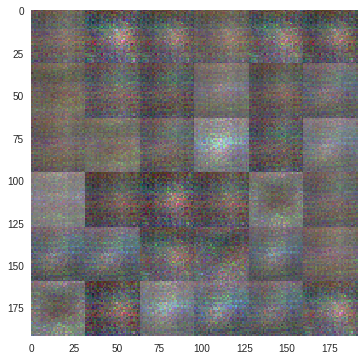

300 (128, 32, 32, 3) Gen Loss: 0.72449 Disc Loss: 1.3943154


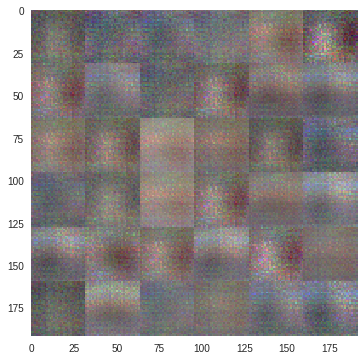

400 (128, 32, 32, 3) Gen Loss: 0.67348707 Disc Loss: 1.4151919


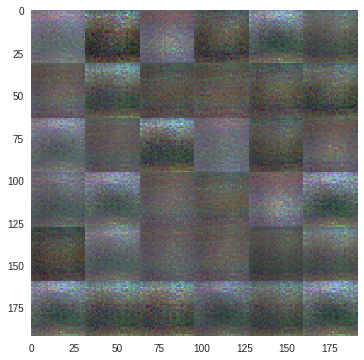

500 (128, 32, 32, 3) Gen Loss: 0.6804066 Disc Loss: 1.419035


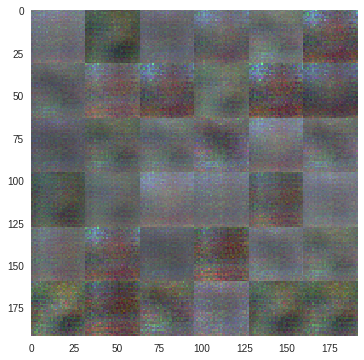

600 (128, 32, 32, 3) Gen Loss: 0.7029805 Disc Loss: 1.4052658


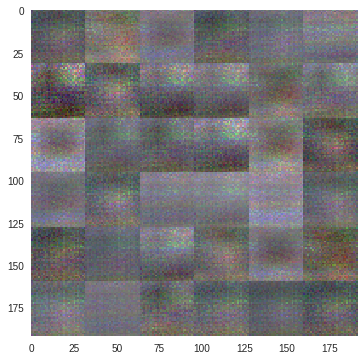

700 (128, 32, 32, 3) Gen Loss: 0.7038754 Disc Loss: 1.3942823


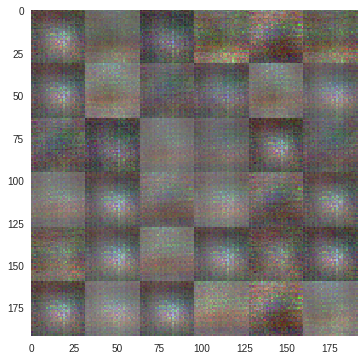

800 (128, 32, 32, 3) Gen Loss: 0.6498866 Disc Loss: 1.4196935


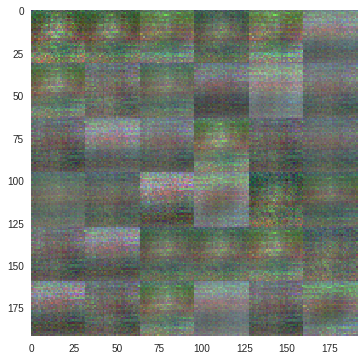

900 (128, 32, 32, 3) Gen Loss: 0.6796537 Disc Loss: 1.4103959


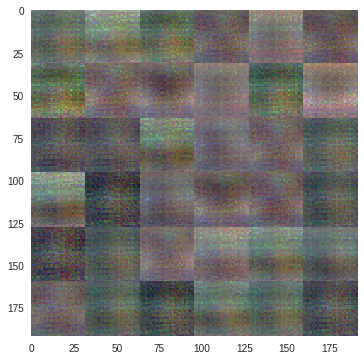

0 (128, 32, 32, 3) Gen Loss: 0.6914703 Disc Loss: 1.3888108


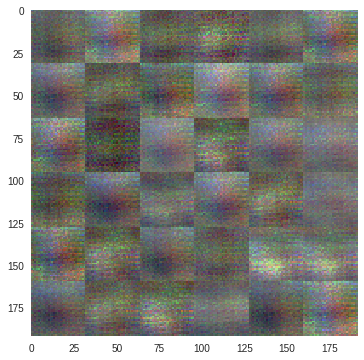

100 (128, 32, 32, 3) Gen Loss: 0.6867468 Disc Loss: 1.4007909


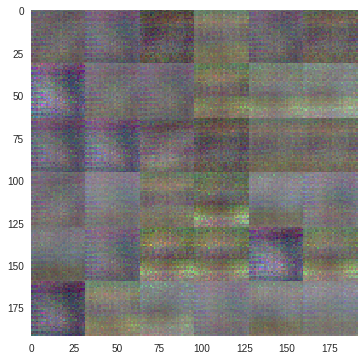

200 (128, 32, 32, 3) Gen Loss: 0.6819563 Disc Loss: 1.4090698


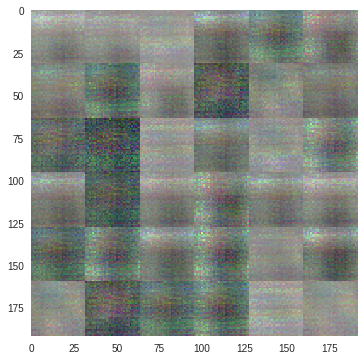

300 (128, 32, 32, 3) Gen Loss: 0.6682739 Disc Loss: 1.4144971


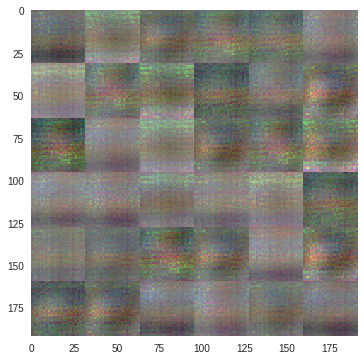

400 (128, 32, 32, 3) Gen Loss: 0.6862731 Disc Loss: 1.4045304


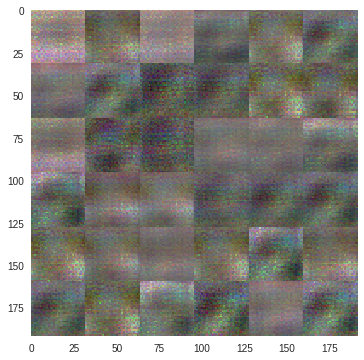

500 (128, 32, 32, 3) Gen Loss: 0.68652296 Disc Loss: 1.3806287


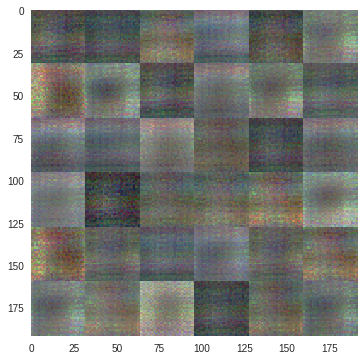

600 (128, 32, 32, 3) Gen Loss: 0.7126759 Disc Loss: 1.4038842


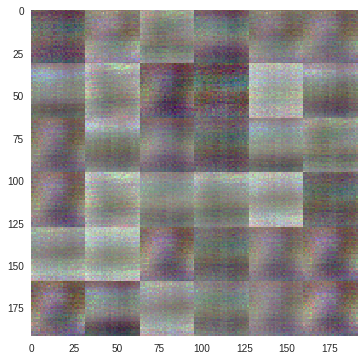

700 (128, 32, 32, 3) Gen Loss: 0.7040749 Disc Loss: 1.3963356


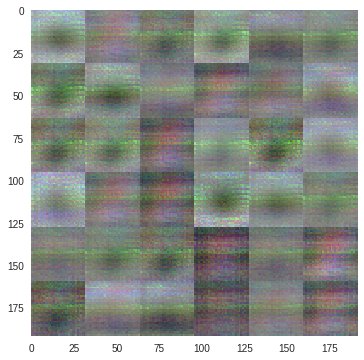

800 (128, 32, 32, 3) Gen Loss: 0.69057167 Disc Loss: 1.3926711


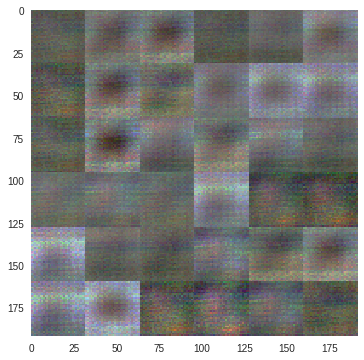

900 (128, 32, 32, 3) Gen Loss: 0.68881536 Disc Loss: 1.3951082


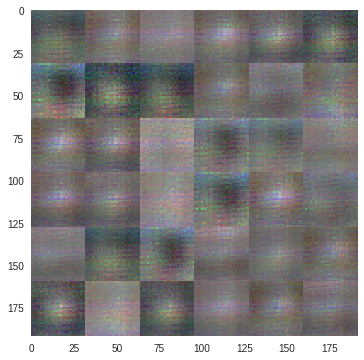

0 (128, 32, 32, 3) Gen Loss: 0.71381104 Disc Loss: 1.4105766


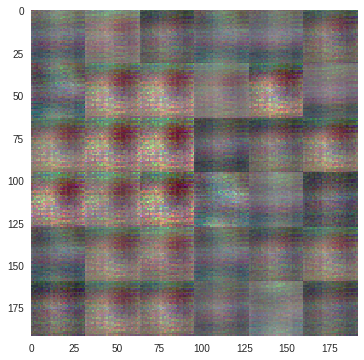

100 (128, 32, 32, 3) Gen Loss: 0.6909597 Disc Loss: 1.4031


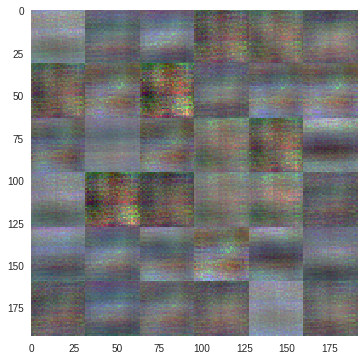

200 (128, 32, 32, 3) Gen Loss: 0.69313645 Disc Loss: 1.4057844


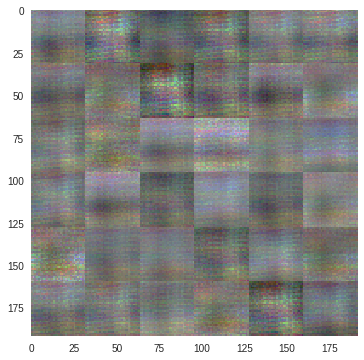

300 (128, 32, 32, 3) Gen Loss: 0.71973413 Disc Loss: 1.3877537


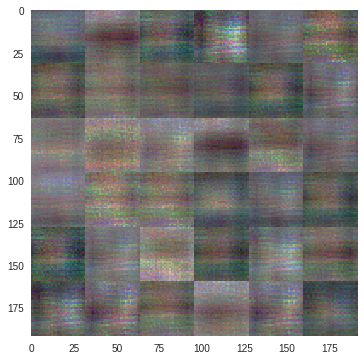

400 (128, 32, 32, 3) Gen Loss: 0.7171564 Disc Loss: 1.4148238


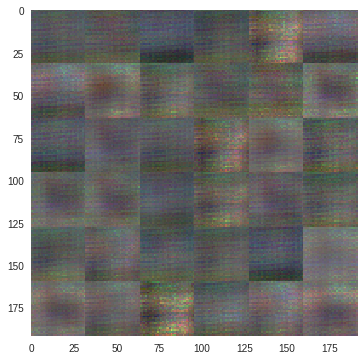

500 (128, 32, 32, 3) Gen Loss: 0.6841517 Disc Loss: 1.3949087


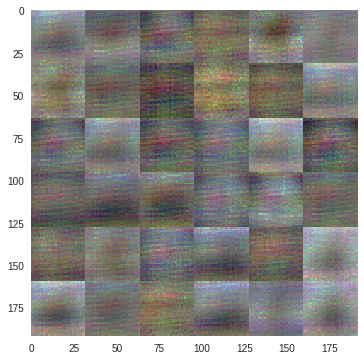

600 (128, 32, 32, 3) Gen Loss: 0.6909149 Disc Loss: 1.3927522


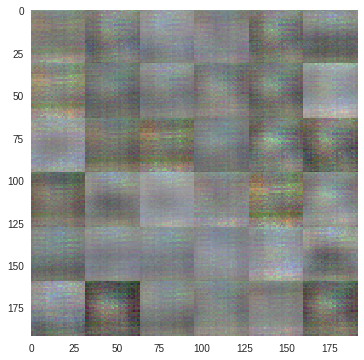

700 (128, 32, 32, 3) Gen Loss: 0.70044875 Disc Loss: 1.4004424


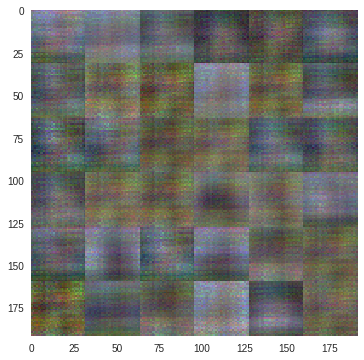

800 (128, 32, 32, 3) Gen Loss: 0.70267534 Disc Loss: 1.4056058


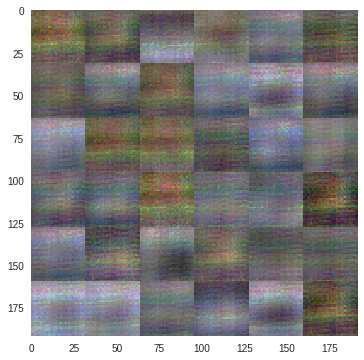

900 (128, 32, 32, 3) Gen Loss: 0.70050925 Disc Loss: 1.3915787


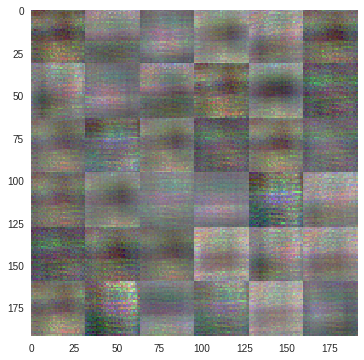

0 (128, 32, 32, 3) Gen Loss: 0.7068478 Disc Loss: 1.3926347


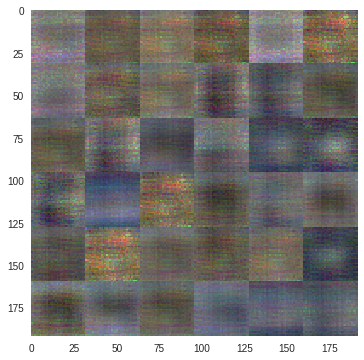

100 (128, 32, 32, 3) Gen Loss: 0.7240212 Disc Loss: 1.3885562


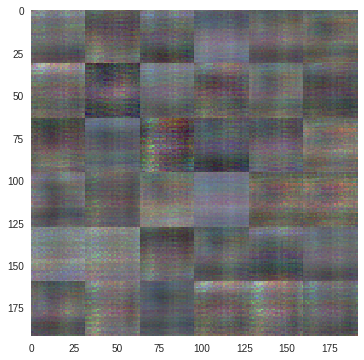

200 (128, 32, 32, 3) Gen Loss: 0.7214591 Disc Loss: 1.3969419


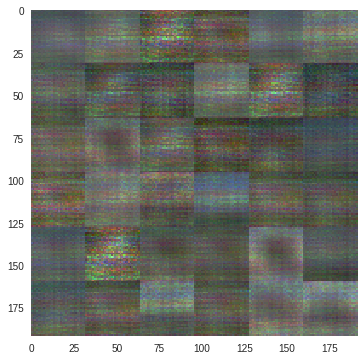

300 (128, 32, 32, 3) Gen Loss: 0.68513715 Disc Loss: 1.3951005


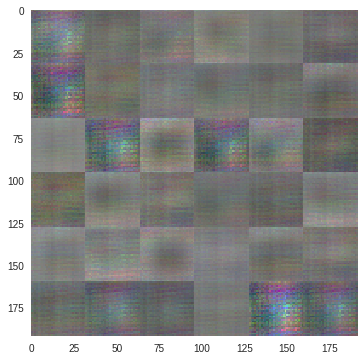

400 (128, 32, 32, 3) Gen Loss: 0.6873419 Disc Loss: 1.391952


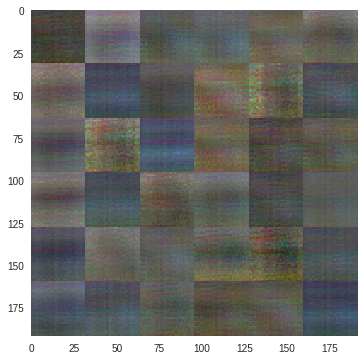

500 (128, 32, 32, 3) Gen Loss: 0.6963842 Disc Loss: 1.3952742


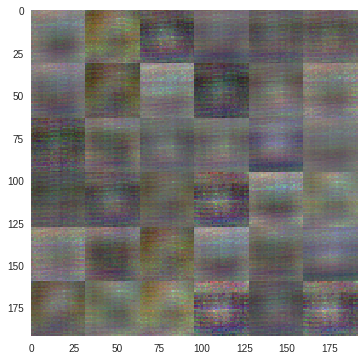

600 (128, 32, 32, 3) Gen Loss: 0.67045 Disc Loss: 1.3952149


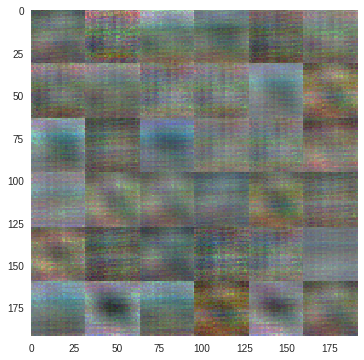

700 (128, 32, 32, 3) Gen Loss: 0.6772337 Disc Loss: 1.3939173


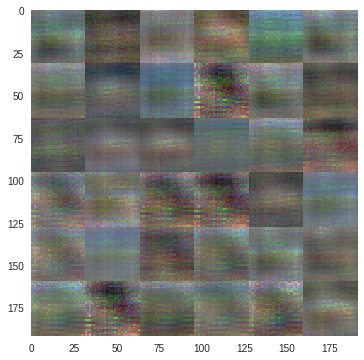

800 (128, 32, 32, 3) Gen Loss: 0.6853975 Disc Loss: 1.4034753


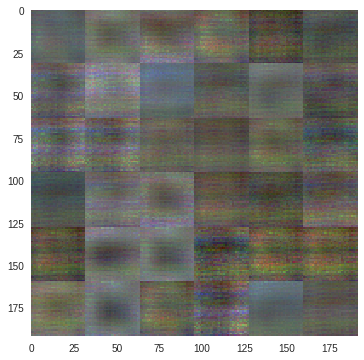

900 (128, 32, 32, 3) Gen Loss: 0.7067679 Disc Loss: 1.3985438


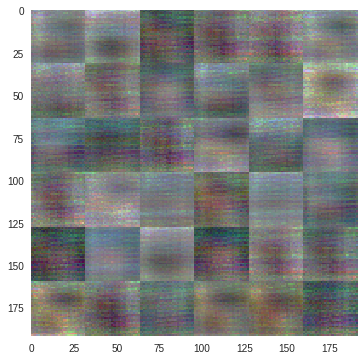

0 (128, 32, 32, 3) Gen Loss: 0.67627215 Disc Loss: 1.4014208


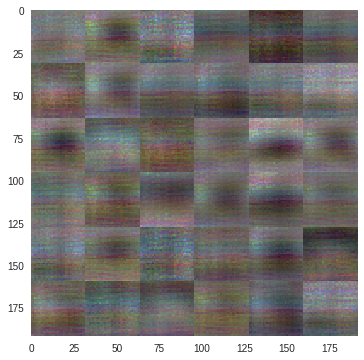

100 (128, 32, 32, 3) Gen Loss: 0.6875733 Disc Loss: 1.3944467


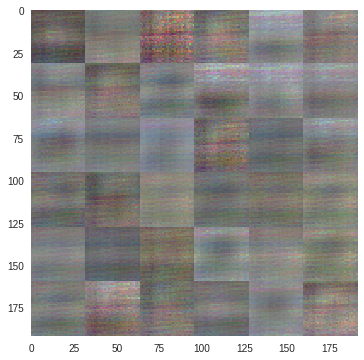

200 (128, 32, 32, 3) Gen Loss: 0.6984495 Disc Loss: 1.3961531


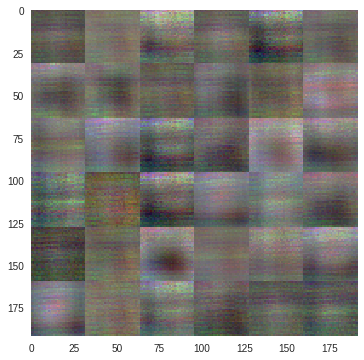

300 (128, 32, 32, 3) Gen Loss: 0.70504004 Disc Loss: 1.3942934


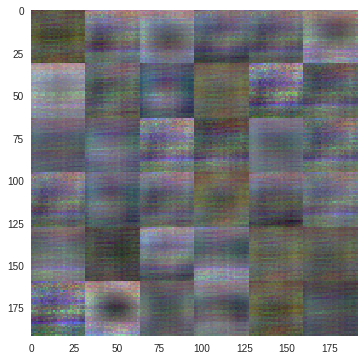

400 (128, 32, 32, 3) Gen Loss: 0.6894022 Disc Loss: 1.4015303


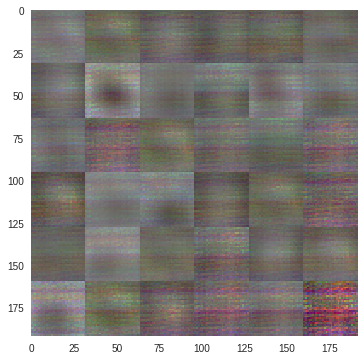

500 (128, 32, 32, 3) Gen Loss: 0.7076552 Disc Loss: 1.3933399


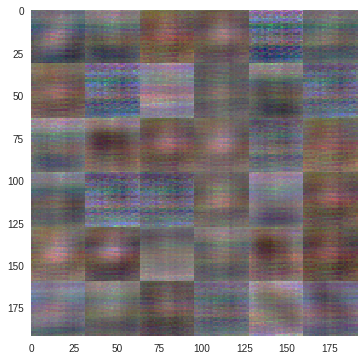

600 (128, 32, 32, 3) Gen Loss: 0.70107424 Disc Loss: 1.3959247


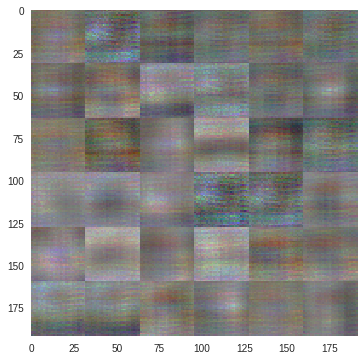

700 (128, 32, 32, 3) Gen Loss: 0.6929413 Disc Loss: 1.3905225


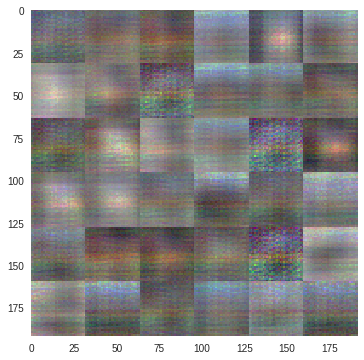

800 (128, 32, 32, 3) Gen Loss: 0.6848359 Disc Loss: 1.4033389


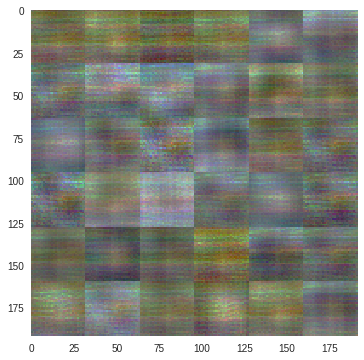

900 (128, 32, 32, 3) Gen Loss: 0.69159675 Disc Loss: 1.389838


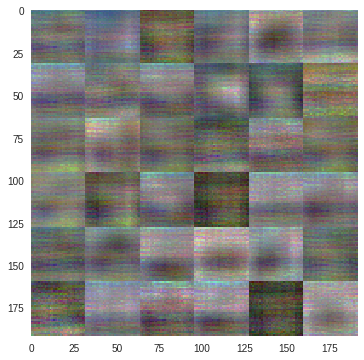

0 (128, 32, 32, 3) Gen Loss: 0.71343505 Disc Loss: 1.3926907


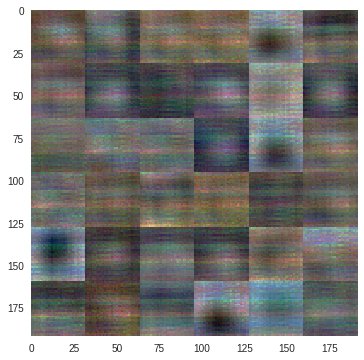

100 (128, 32, 32, 3) Gen Loss: 0.70046914 Disc Loss: 1.3916577


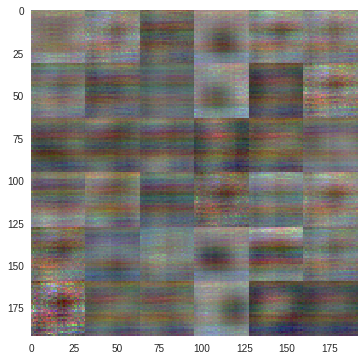

200 (128, 32, 32, 3) Gen Loss: 0.67431474 Disc Loss: 1.4073284


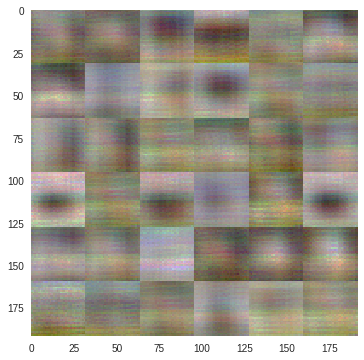

300 (128, 32, 32, 3) Gen Loss: 0.68276286 Disc Loss: 1.3922256


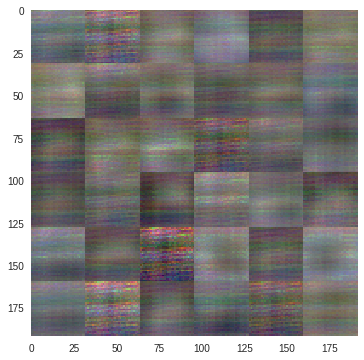

400 (128, 32, 32, 3) Gen Loss: 0.6979474 Disc Loss: 1.3884883


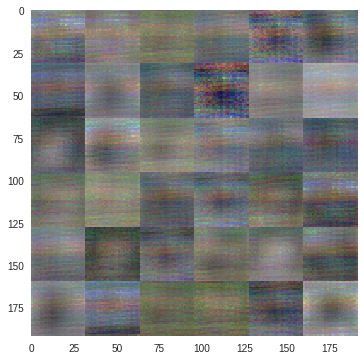

500 (128, 32, 32, 3) Gen Loss: 0.6867404 Disc Loss: 1.3907118


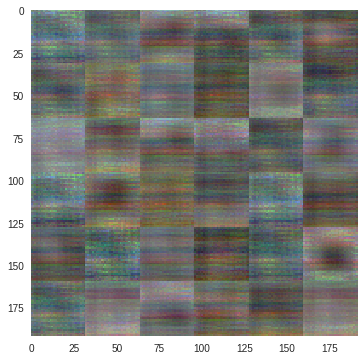

600 (128, 32, 32, 3) Gen Loss: 0.6955945 Disc Loss: 1.3952053


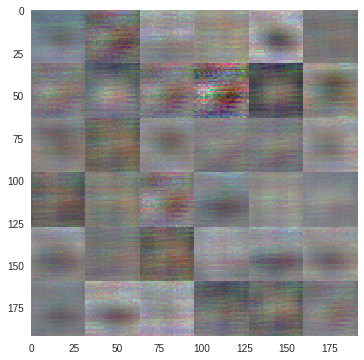

700 (128, 32, 32, 3) Gen Loss: 0.7042405 Disc Loss: 1.3929892


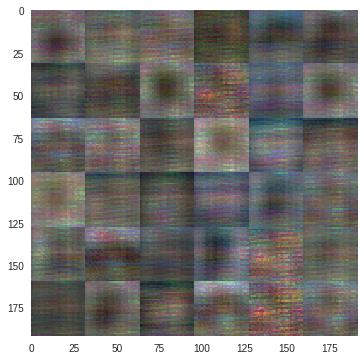

800 (128, 32, 32, 3) Gen Loss: 0.70354927 Disc Loss: 1.3933867


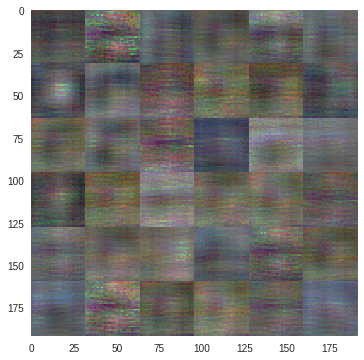

900 (128, 32, 32, 3) Gen Loss: 0.6811208 Disc Loss: 1.3939757


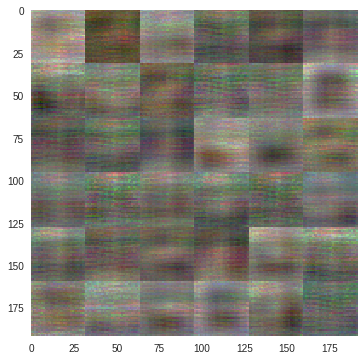

0 (128, 32, 32, 3) Gen Loss: 0.7087003 Disc Loss: 1.3905438


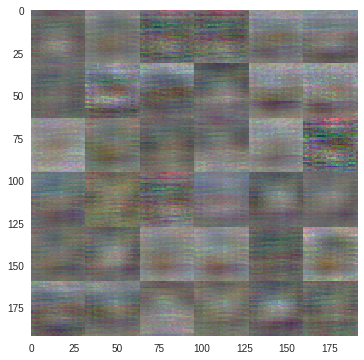

100 (128, 32, 32, 3) Gen Loss: 0.6779147 Disc Loss: 1.3903596


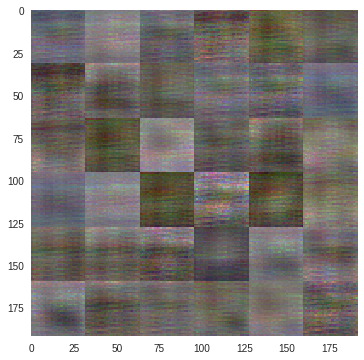

200 (128, 32, 32, 3) Gen Loss: 0.72033334 Disc Loss: 1.3987892


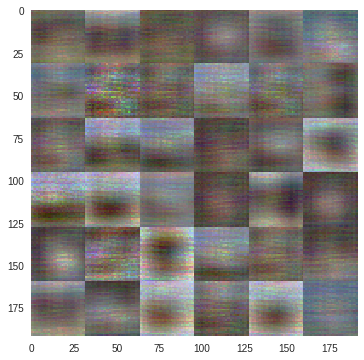

300 (128, 32, 32, 3) Gen Loss: 0.68157804 Disc Loss: 1.3905065


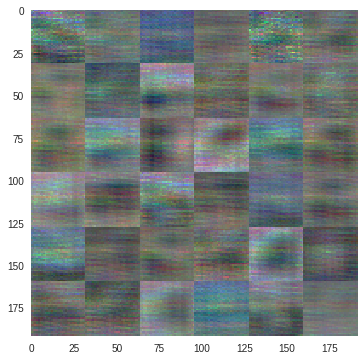

400 (128, 32, 32, 3) Gen Loss: 0.70409167 Disc Loss: 1.3952675


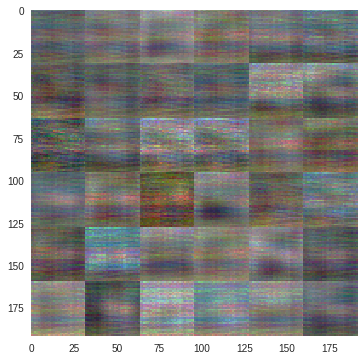

500 (128, 32, 32, 3) Gen Loss: 0.7067169 Disc Loss: 1.3892688


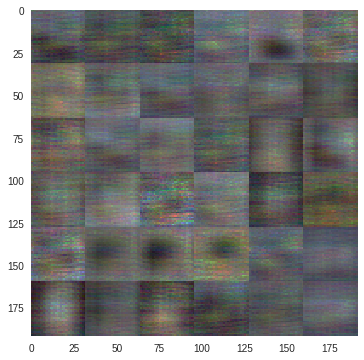

600 (128, 32, 32, 3) Gen Loss: 0.6859404 Disc Loss: 1.3953731


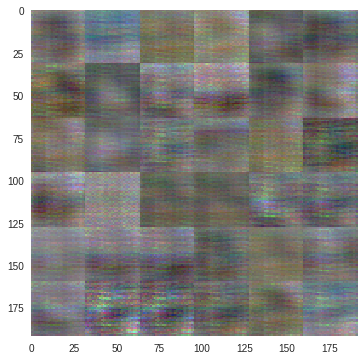

700 (128, 32, 32, 3) Gen Loss: 0.68889856 Disc Loss: 1.395083


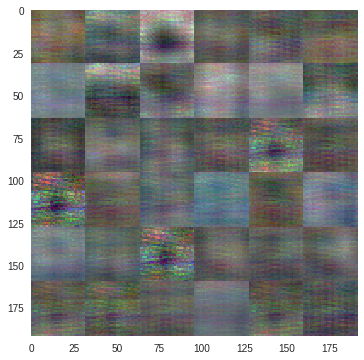

800 (128, 32, 32, 3) Gen Loss: 0.68558663 Disc Loss: 1.391325


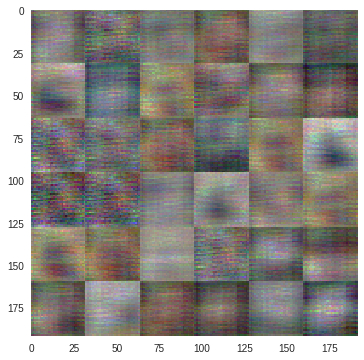

900 (128, 32, 32, 3) Gen Loss: 0.64699614 Disc Loss: 1.3950927


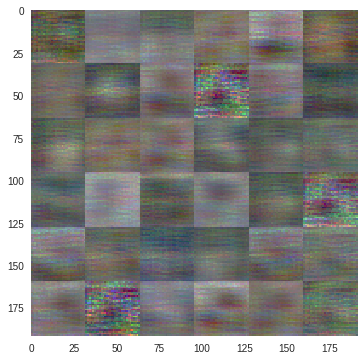

0 (128, 32, 32, 3) Gen Loss: 0.68233824 Disc Loss: 1.3909725


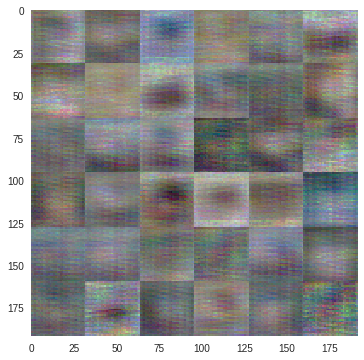

100 (128, 32, 32, 3) Gen Loss: 0.67615294 Disc Loss: 1.3928357


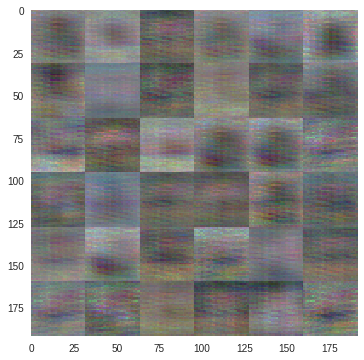

200 (128, 32, 32, 3) Gen Loss: 0.6893793 Disc Loss: 1.3893783


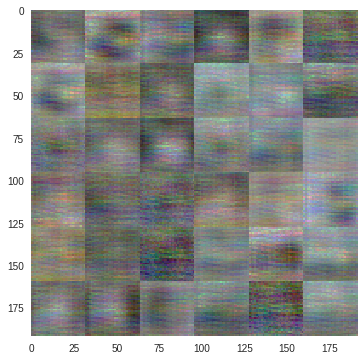

300 (128, 32, 32, 3) Gen Loss: 0.6955056 Disc Loss: 1.3921592


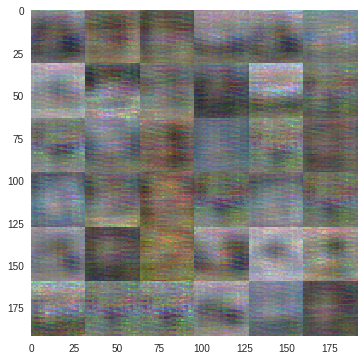

400 (128, 32, 32, 3) Gen Loss: 0.68490744 Disc Loss: 1.3934772


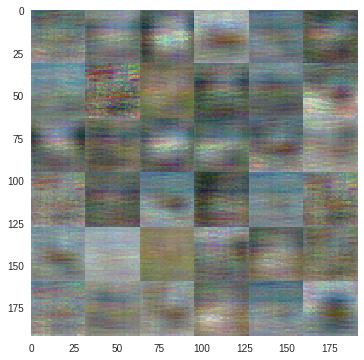

500 (128, 32, 32, 3) Gen Loss: 0.6842284 Disc Loss: 1.386965


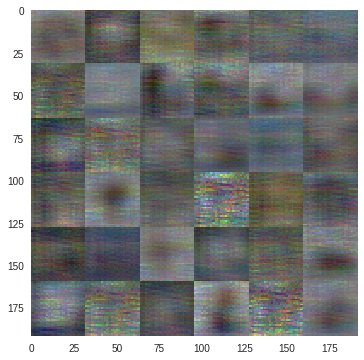

600 (128, 32, 32, 3) Gen Loss: 0.7232782 Disc Loss: 1.4008855


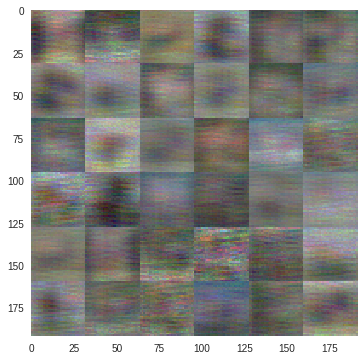

700 (128, 32, 32, 3) Gen Loss: 0.71164465 Disc Loss: 1.3930591


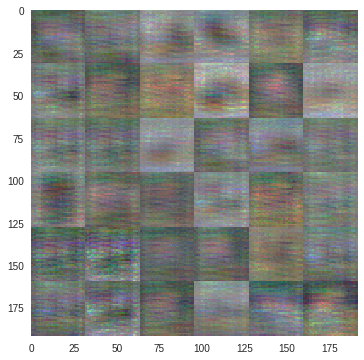

800 (128, 32, 32, 3) Gen Loss: 0.70509976 Disc Loss: 1.3862249


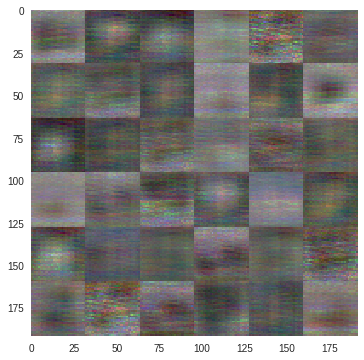

900 (128, 32, 32, 3) Gen Loss: 0.6843609 Disc Loss: 1.3912153


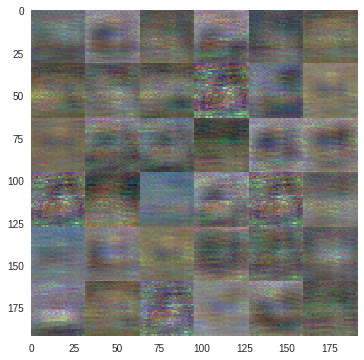

0 (128, 32, 32, 3) Gen Loss: 0.705001 Disc Loss: 1.3917522


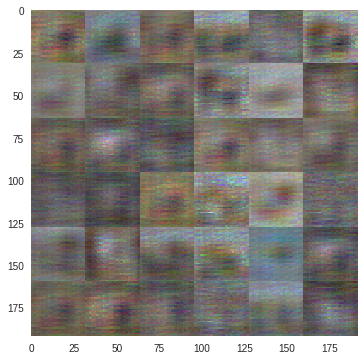

100 (128, 32, 32, 3) Gen Loss: 0.7030948 Disc Loss: 1.3997395


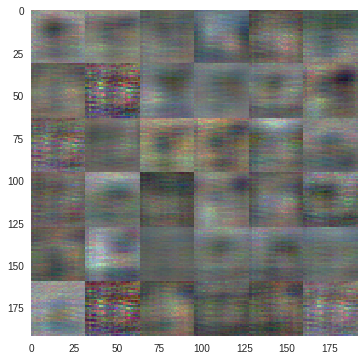

200 (128, 32, 32, 3) Gen Loss: 0.71149206 Disc Loss: 1.3949454


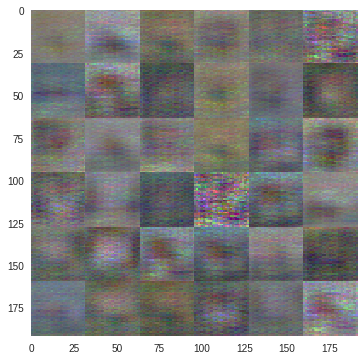

300 (128, 32, 32, 3) Gen Loss: 0.6785613 Disc Loss: 1.3893263


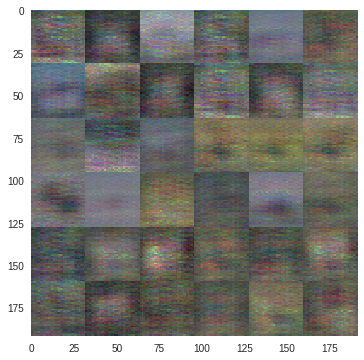

400 (128, 32, 32, 3) Gen Loss: 0.6920861 Disc Loss: 1.3882494


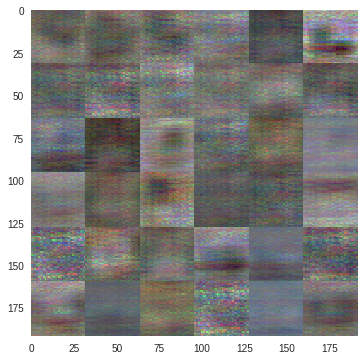

500 (128, 32, 32, 3) Gen Loss: 0.70418024 Disc Loss: 1.3912024


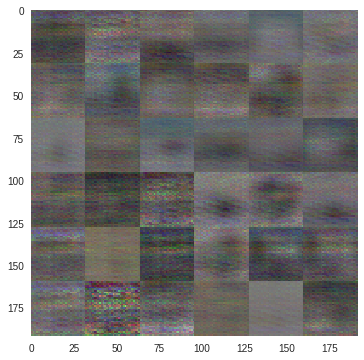

600 (128, 32, 32, 3) Gen Loss: 0.70306146 Disc Loss: 1.3931112


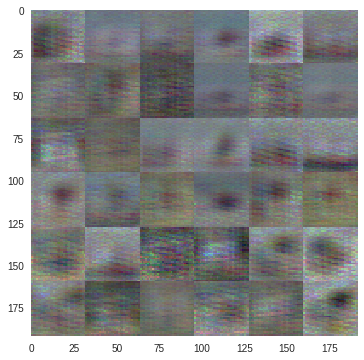

700 (128, 32, 32, 3) Gen Loss: 0.6993817 Disc Loss: 1.3770461


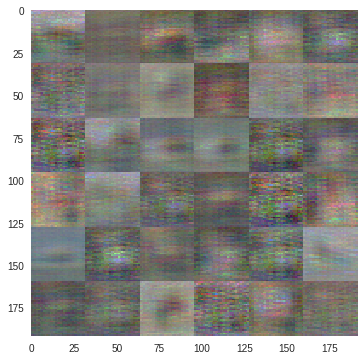

800 (128, 32, 32, 3) Gen Loss: 0.7017303 Disc Loss: 1.4099243


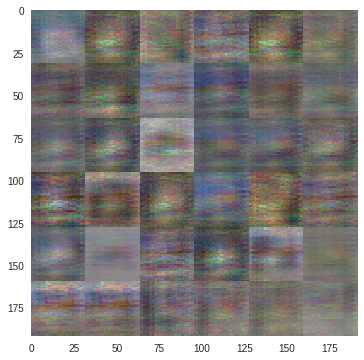

900 (128, 32, 32, 3) Gen Loss: 0.697711 Disc Loss: 1.3759215


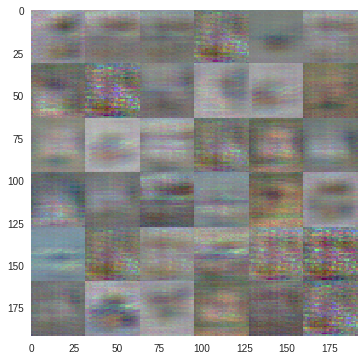

0 (128, 32, 32, 3) Gen Loss: 0.7131625 Disc Loss: 1.3768985


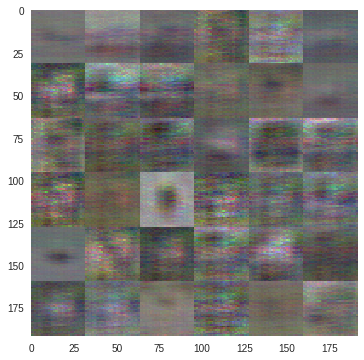

100 (128, 32, 32, 3) Gen Loss: 0.7411328 Disc Loss: 1.374375


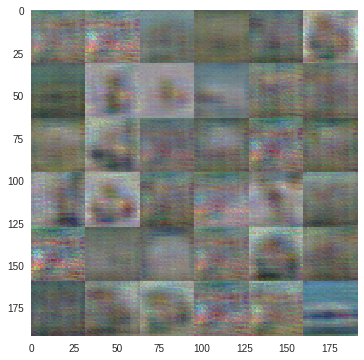

200 (128, 32, 32, 3) Gen Loss: 0.81698453 Disc Loss: 1.3231905


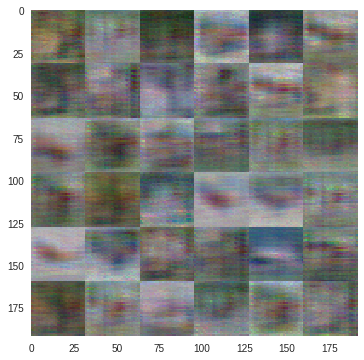

300 (128, 32, 32, 3) Gen Loss: 0.8797307 Disc Loss: 1.2915903


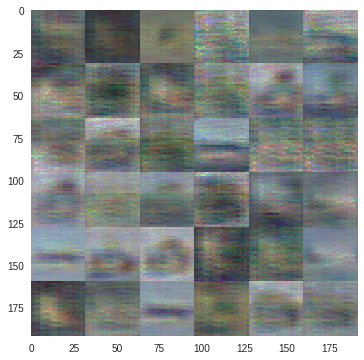

400 (128, 32, 32, 3) Gen Loss: 1.3236638 Disc Loss: 1.1080667


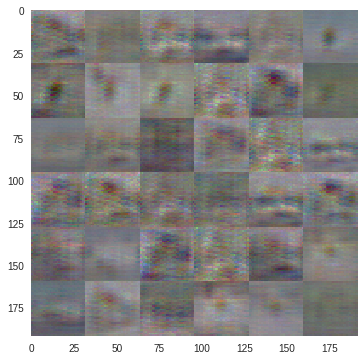

500 (128, 32, 32, 3) Gen Loss: 1.1151266 Disc Loss: 1.283859


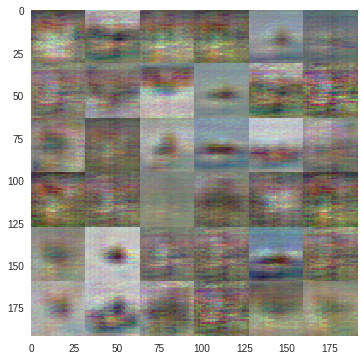

600 (128, 32, 32, 3) Gen Loss: 0.91935 Disc Loss: 1.2456988


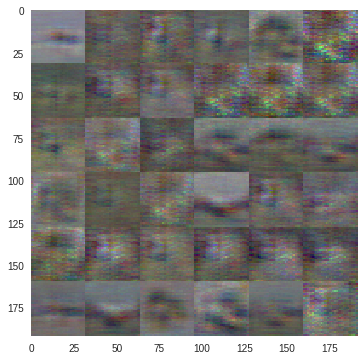

700 (128, 32, 32, 3) Gen Loss: 1.1062894 Disc Loss: 1.1495317


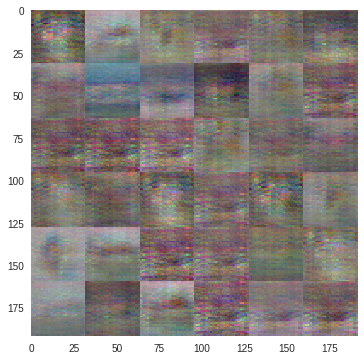

800 (128, 32, 32, 3) Gen Loss: 1.4531034 Disc Loss: 1.1720914


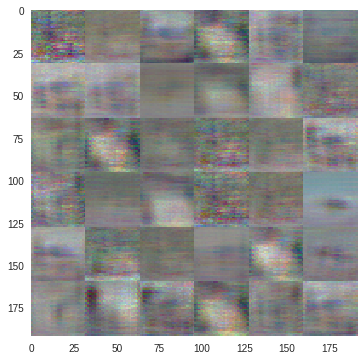

900 (128, 32, 32, 3) Gen Loss: 1.3347433 Disc Loss: 0.9458619


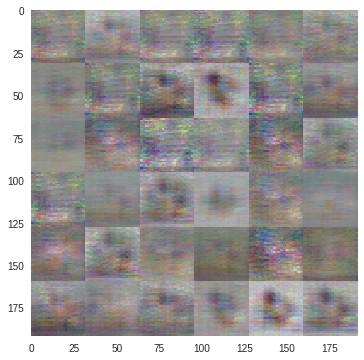

0 (128, 32, 32, 3) Gen Loss: 1.1147826 Disc Loss: 1.0327225


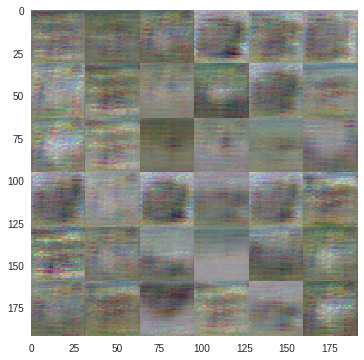

100 (128, 32, 32, 3) Gen Loss: 1.6786503 Disc Loss: 1.0241978


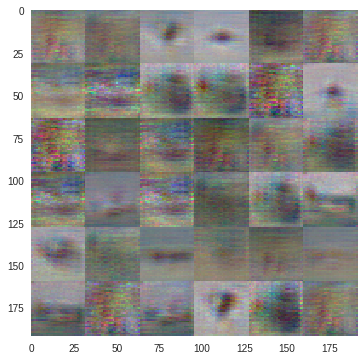

200 (128, 32, 32, 3) Gen Loss: 1.6270803 Disc Loss: 1.0439966


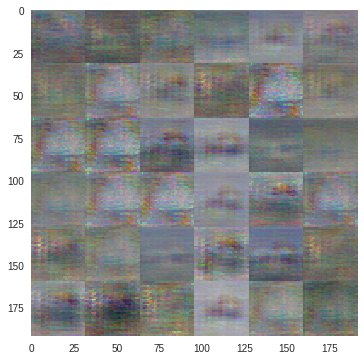

300 (128, 32, 32, 3) Gen Loss: 1.7040371 Disc Loss: 0.8590457


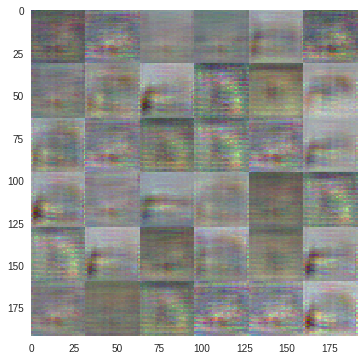

400 (128, 32, 32, 3) Gen Loss: 1.8533366 Disc Loss: 0.80692154


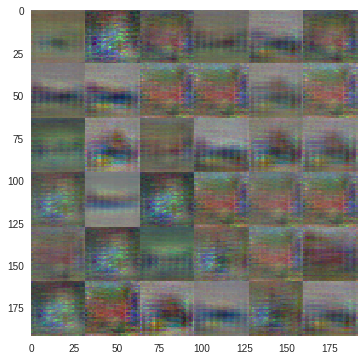

500 (128, 32, 32, 3) Gen Loss: 1.3922825 Disc Loss: 0.9435306


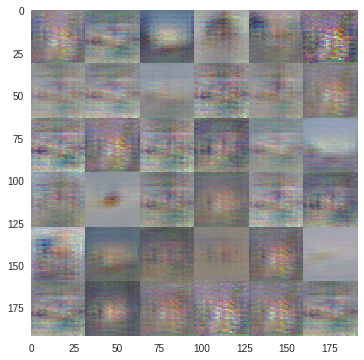

600 (128, 32, 32, 3) Gen Loss: 1.1013939 Disc Loss: 1.1757629


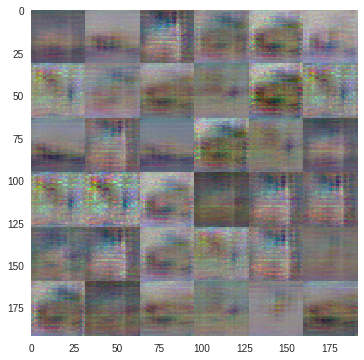

700 (128, 32, 32, 3) Gen Loss: 1.6865141 Disc Loss: 1.1197903


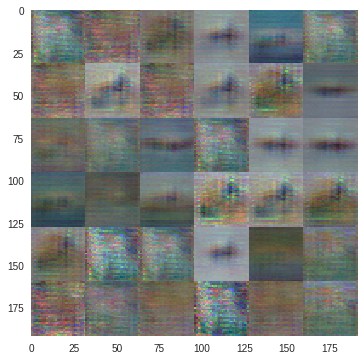

800 (128, 32, 32, 3) Gen Loss: 1.2850301 Disc Loss: 1.00561


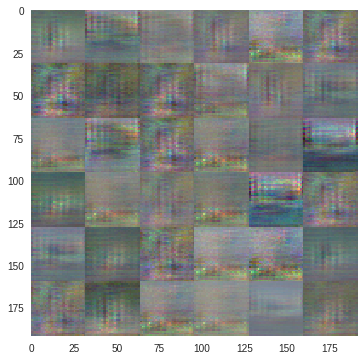

900 (128, 32, 32, 3) Gen Loss: 1.2553931 Disc Loss: 1.0620344


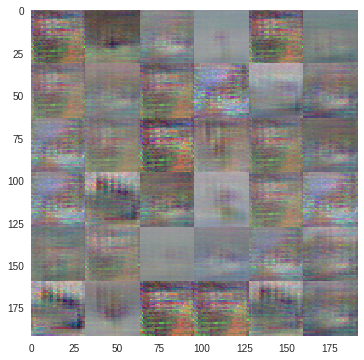

0 (128, 32, 32, 3) Gen Loss: 1.0146506 Disc Loss: 1.1033466


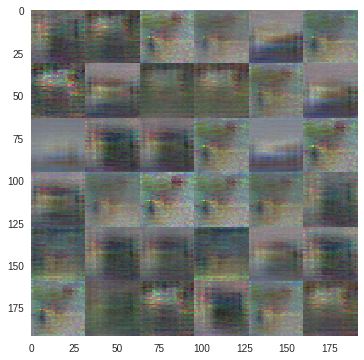

100 (128, 32, 32, 3) Gen Loss: 1.255635 Disc Loss: 1.3805252


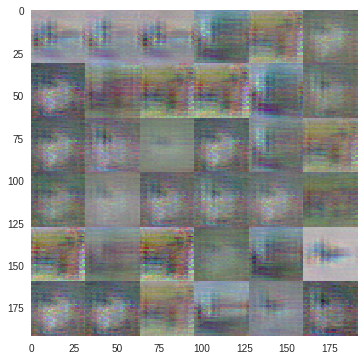

200 (128, 32, 32, 3) Gen Loss: 1.6353295 Disc Loss: 1.1136954


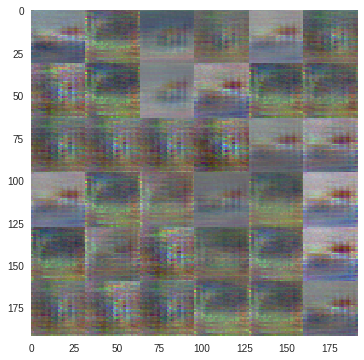

300 (128, 32, 32, 3) Gen Loss: 1.0593741 Disc Loss: 1.0852563


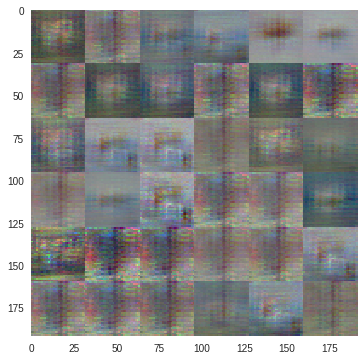

400 (128, 32, 32, 3) Gen Loss: 1.4173732 Disc Loss: 0.99803615


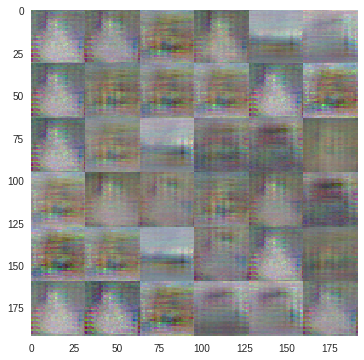

500 (128, 32, 32, 3) Gen Loss: 1.8047893 Disc Loss: 1.3273313


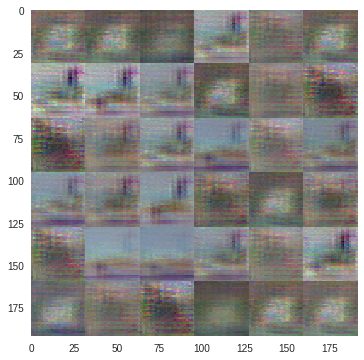

600 (128, 32, 32, 3) Gen Loss: 1.7087677 Disc Loss: 0.9012066


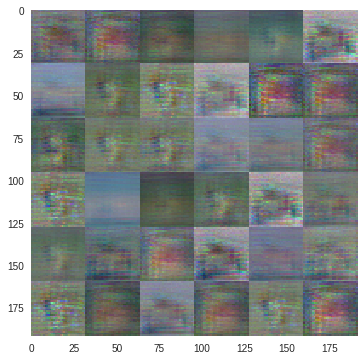

700 (128, 32, 32, 3) Gen Loss: 1.1452835 Disc Loss: 1.125144


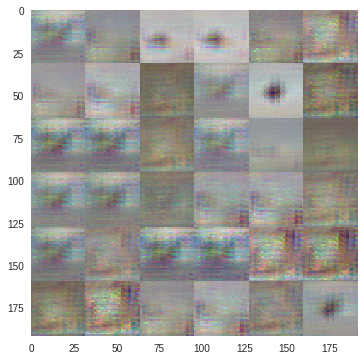

800 (128, 32, 32, 3) Gen Loss: 1.2531657 Disc Loss: 0.8733622


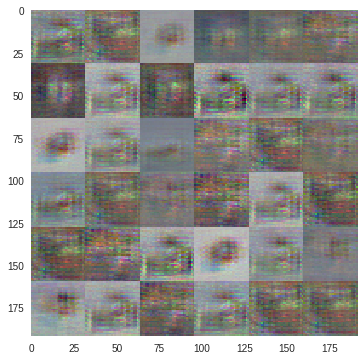

900 (128, 32, 32, 3) Gen Loss: 1.1528289 Disc Loss: 1.1442733


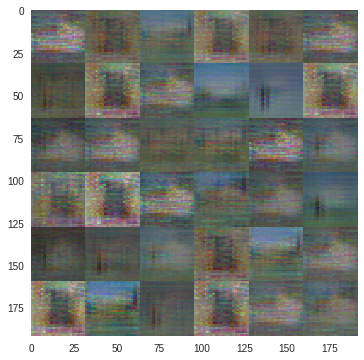

0 (128, 32, 32, 3) Gen Loss: 1.0112071 Disc Loss: 1.3043146


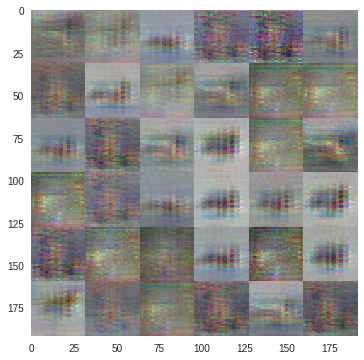

100 (128, 32, 32, 3) Gen Loss: 1.3107569 Disc Loss: 0.7908273


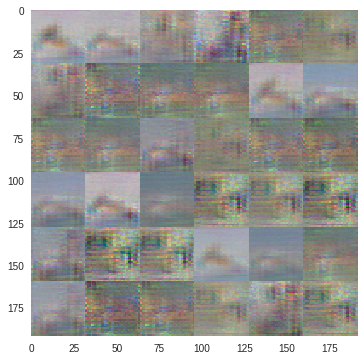

200 (128, 32, 32, 3) Gen Loss: 1.5191816 Disc Loss: 0.85977226


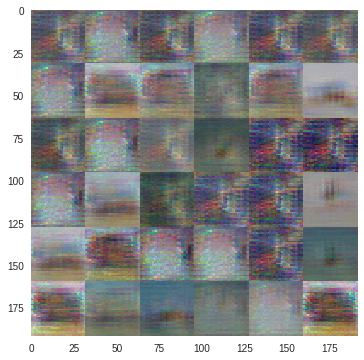

300 (128, 32, 32, 3) Gen Loss: 1.6338376 Disc Loss: 0.92702866


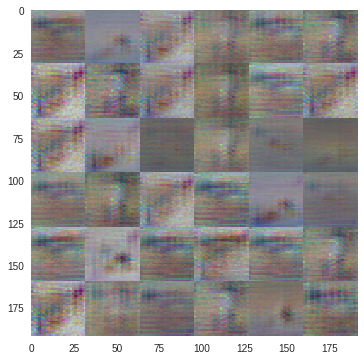

400 (128, 32, 32, 3) Gen Loss: 0.8681855 Disc Loss: 1.3400004


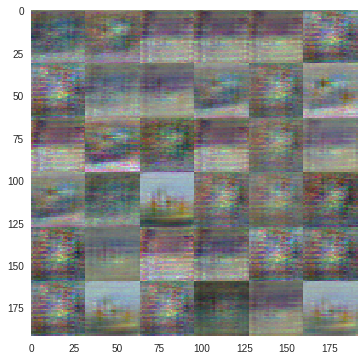

500 (128, 32, 32, 3) Gen Loss: 1.1876093 Disc Loss: 1.0653627


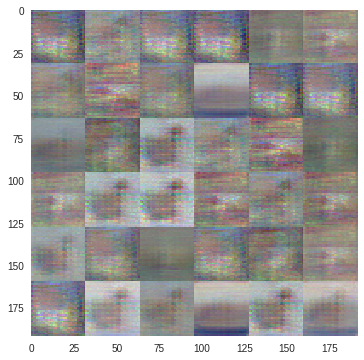

600 (128, 32, 32, 3) Gen Loss: 1.0607597 Disc Loss: 0.8391663


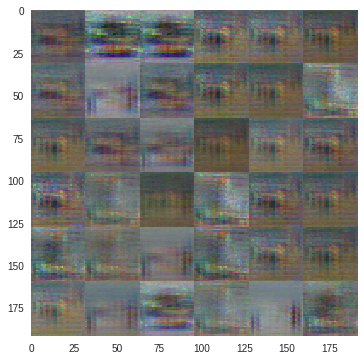

700 (128, 32, 32, 3) Gen Loss: 1.0694292 Disc Loss: 1.1828984


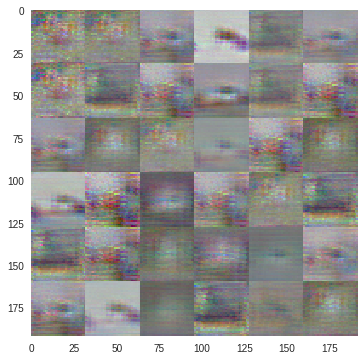

800 (128, 32, 32, 3) Gen Loss: 1.3222175 Disc Loss: 1.2366784


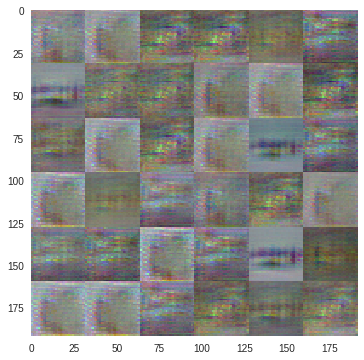

900 (128, 32, 32, 3) Gen Loss: 1.1422069 Disc Loss: 1.3055522


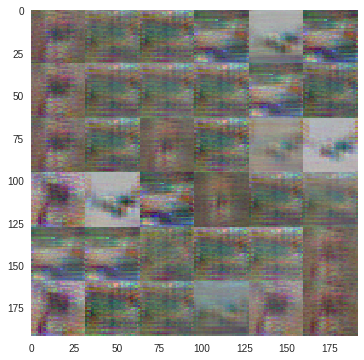

0 (128, 32, 32, 3) Gen Loss: 1.1269327 Disc Loss: 1.1973882


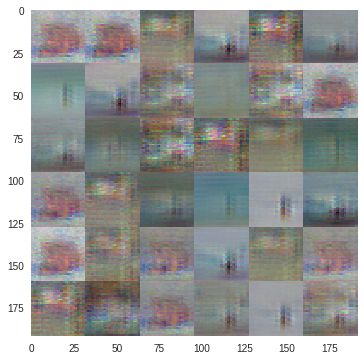

100 (128, 32, 32, 3) Gen Loss: 1.3659593 Disc Loss: 0.8741368


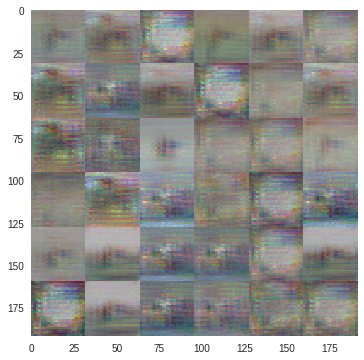

200 (128, 32, 32, 3) Gen Loss: 1.1418378 Disc Loss: 1.159416


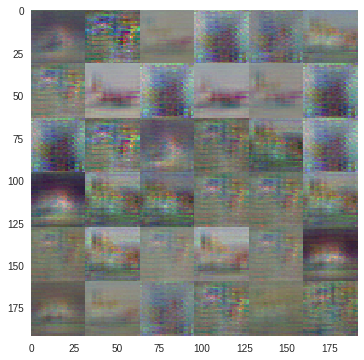

300 (128, 32, 32, 3) Gen Loss: 0.9776913 Disc Loss: 1.2874074


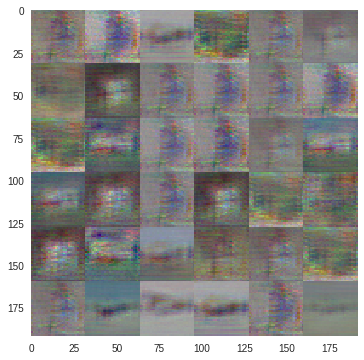

400 (128, 32, 32, 3) Gen Loss: 1.1218711 Disc Loss: 0.93919444


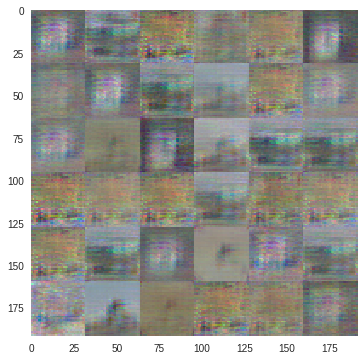

500 (128, 32, 32, 3) Gen Loss: 1.4026275 Disc Loss: 1.3014798


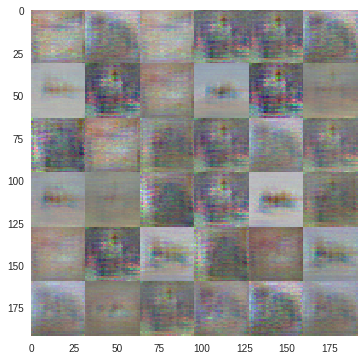

600 (128, 32, 32, 3) Gen Loss: 1.2275487 Disc Loss: 1.0836017


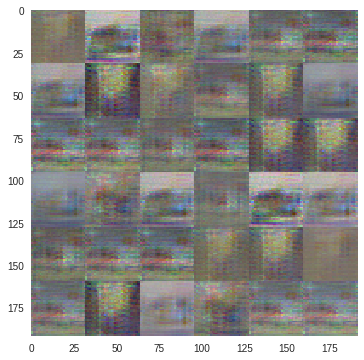

700 (128, 32, 32, 3) Gen Loss: 1.0405197 Disc Loss: 0.96675736


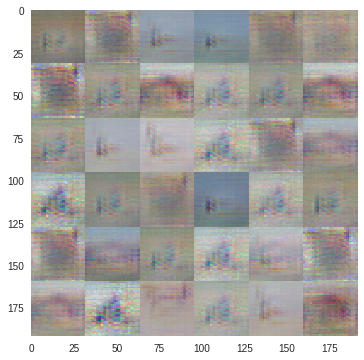

800 (128, 32, 32, 3) Gen Loss: 1.9458141 Disc Loss: 1.1745257


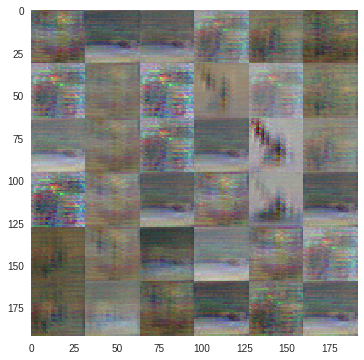

900 (128, 32, 32, 3) Gen Loss: 1.1583287 Disc Loss: 0.99512494


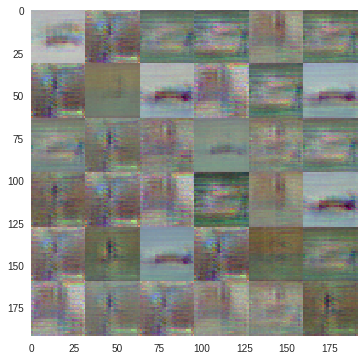

0 (128, 32, 32, 3) Gen Loss: 1.1015191 Disc Loss: 1.0005374


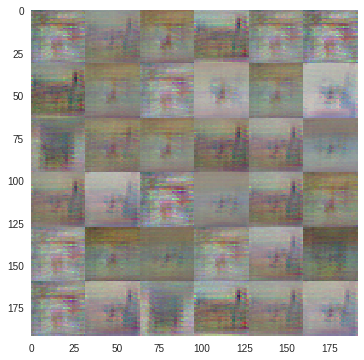

100 (128, 32, 32, 3) Gen Loss: 1.1100541 Disc Loss: 1.0476742


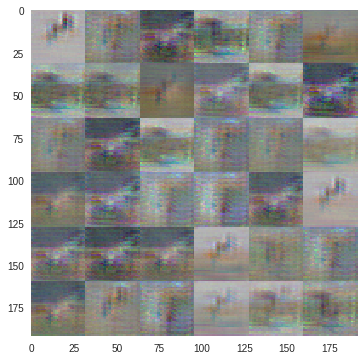

200 (128, 32, 32, 3) Gen Loss: 1.0927441 Disc Loss: 1.2438449


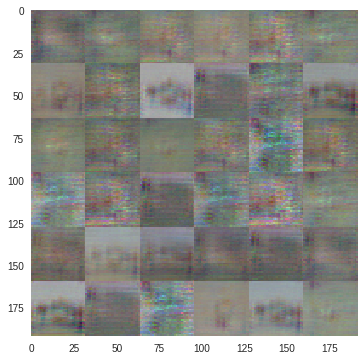

300 (128, 32, 32, 3) Gen Loss: 1.0261135 Disc Loss: 1.1051614


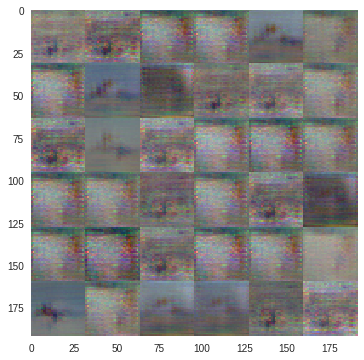

400 (128, 32, 32, 3) Gen Loss: 1.2940328 Disc Loss: 1.0041633


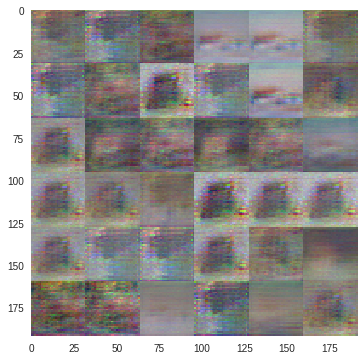

500 (128, 32, 32, 3) Gen Loss: 1.2531157 Disc Loss: 1.2003669


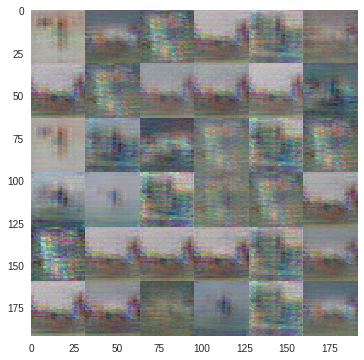

600 (128, 32, 32, 3) Gen Loss: 1.0417182 Disc Loss: 1.1548429


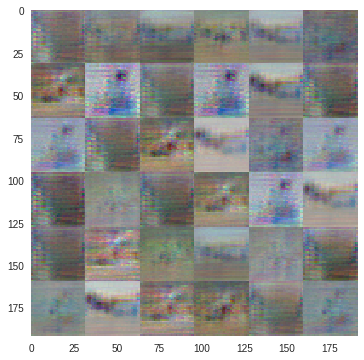

700 (128, 32, 32, 3) Gen Loss: 1.1704572 Disc Loss: 1.0669951


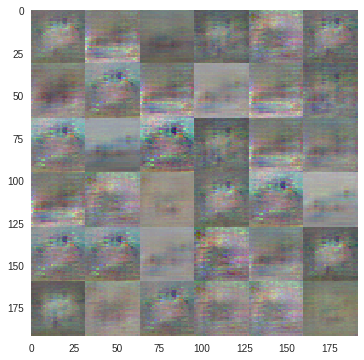

800 (128, 32, 32, 3) Gen Loss: 1.2933766 Disc Loss: 1.0112263


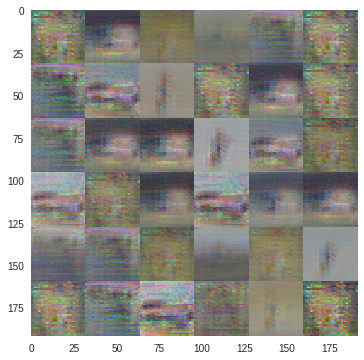

900 (128, 32, 32, 3) Gen Loss: 1.0396757 Disc Loss: 1.2726986


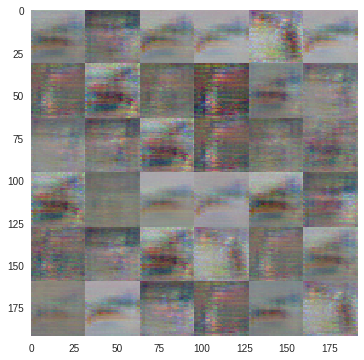

0 (128, 32, 32, 3) Gen Loss: 1.0270852 Disc Loss: 1.0105642


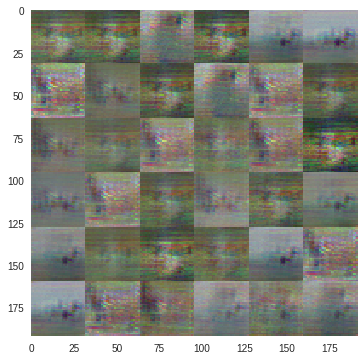

100 (128, 32, 32, 3) Gen Loss: 1.2611302 Disc Loss: 0.91263086


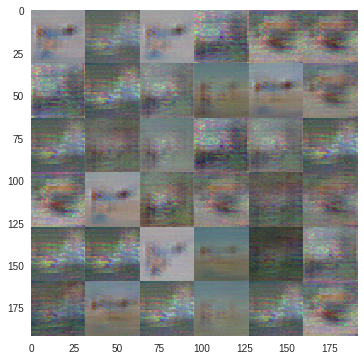

200 (128, 32, 32, 3) Gen Loss: 0.9336316 Disc Loss: 1.3211935


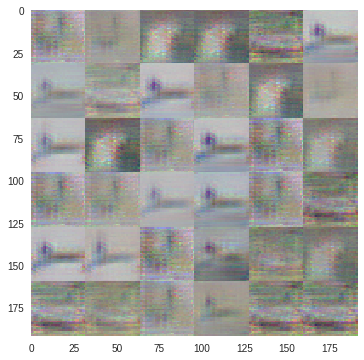

300 (128, 32, 32, 3) Gen Loss: 1.0918298 Disc Loss: 0.87550795


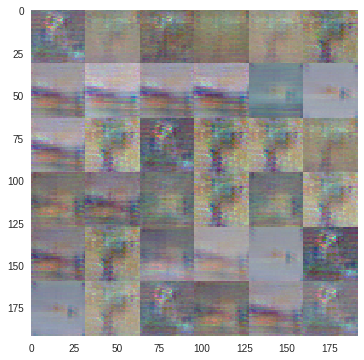

400 (128, 32, 32, 3) Gen Loss: 1.3288801 Disc Loss: 1.100232


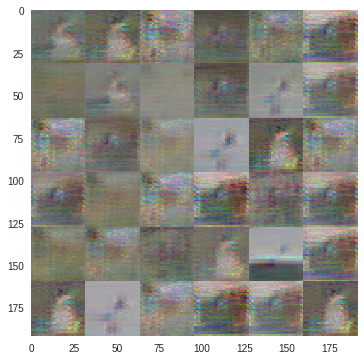

500 (128, 32, 32, 3) Gen Loss: 0.85253584 Disc Loss: 1.126972


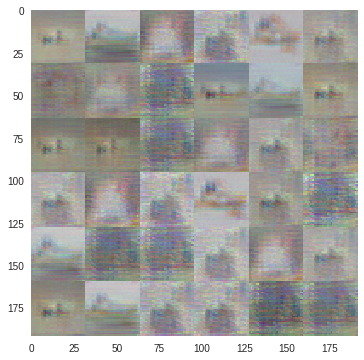

600 (128, 32, 32, 3) Gen Loss: 1.0860494 Disc Loss: 1.2029665


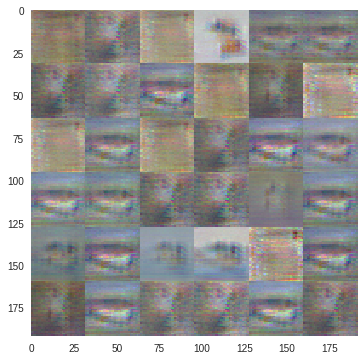

700 (128, 32, 32, 3) Gen Loss: 1.1136506 Disc Loss: 0.9655416


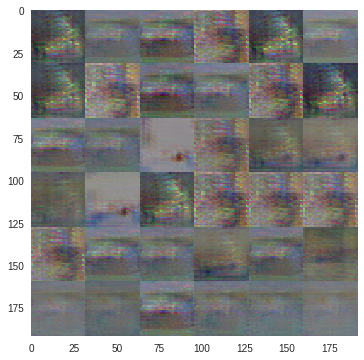

800 (128, 32, 32, 3) Gen Loss: 0.80751944 Disc Loss: 1.21822


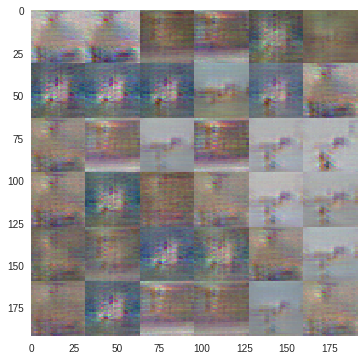

In [0]:
batch_size = 128 #Size of image batch to apply at each iteration.
epochs = 50 #Total number of iterations to use.
#sample_directory = './figs' #Directory to save sample images from generator in.
#model_directory = './models' #Directory to save trained model to.

np.random.shuffle(train_X)
init = tf.global_variables_initializer()
#saver = tf.train.Saver()
with tf.Session() as sess:  
    sess.run(init)
    for epoch in range(epochs):
        i = 0
        np.random.shuffle(train_X)
        batches = train_X.shape[0]//batch_size
        while i < batches:
          zs = np.random.uniform(-1.0,1.0,size=[batch_size,z_size]).astype(np.float32) #Generate a random z batch
          xs = train_X[i*batch_size:(i+1)*batch_size]
          xs = (np.reshape(xs,[batch_size,32,32,3]) - 0.5) * 2.0 #Transform it to be between -1 and 1
          #xs = np.lib.pad(xs, ((0,0),(2,2),(2,2),(0,0)),'constant', constant_values=(-1, -1)) #Pad the images so the are 32x32
          _,dLoss = sess.run([update_D,d_loss],feed_dict={z_in:zs,real_in:xs}) #Update the discriminator
          _,gLoss = sess.run([update_G,g_loss],feed_dict={z_in:zs}) #Update the generator, twice for good measure.
          _,gLoss = sess.run([update_G,g_loss],feed_dict={z_in:zs})
          if i % 100 == 0:
              print(i, xs.shape,"Gen Loss: " + str(gLoss) + " Disc Loss: " + str(dLoss))
              n = 6
              canvas = np.empty((32 * n, 32 * n, 3))
              for j in range(n):
                  for k in range(n):
                      z2 = np.random.uniform(-1.0,1.0,size=[batch_size,z_size]).astype(np.float32) #Generate another z batch
                      newZ = sess.run(Gz,feed_dict={z_in:z2}) #Use new z to get sample images from generator.
                      newZ = np.moveaxis(newZ.reshape(-1,3,32,32), 1, 3)
                      newZ = (newZ - np.min(newZ))/(np.max(newZ) - np.min(newZ))
                      # Draw the generated digits
                      canvas[j * 32:(j + 1) * 32, k * 32:(k + 1) * 32, 0:3] = newZ[j].reshape([32, 32, 3])
              #canvas = np.moveaxis(canvas.reshape(-1,3,32,32), 1, 3)
              #canvas = (canvas - np.min(canvas))/(np.max(canvas) - np.min(canvas))
              plt.figure(figsize=(n, n))
              ax = plt.gca()
              ax.grid(False)
              plt.imshow(canvas, origin="upper", cmap=None)
              plt.show()
          i += 1
            
              #if not os.path.exists(sample_directory):
              #    os.makedirs(sample_directory)
              #Save sample generator images for viewing training progress.
              #save_images(np.reshape(newZ[0:36],[36,32,32]),[6,6],sample_directory+'/fig'+str(i)+'.png')
          #if i % 1000 == 0 and i != 0:
              #if not os.path.exists(model_directory):
              #    os.makedirs(model_directory)
                  #saver.save(sess,model_directory+'/model-'+str(i)+'.cptk')
                  #print("Saved Model")

## Using a trained network
Once we have a trained model saved, we may want to use it to generate new images, and explore the representation it has learned.

In [0]:
"""
sample_directory = './figs' #Directory to save sample images from generator in.
model_directory = './models' #Directory to load trained model from.
batch_size_sample = 36

init = tf.global_variables_initializer()
saver = tf.train.Saver()
with tf.Session() as sess:  
    sess.run(init)
    #Reload the model.
    print('Loading Model...')
    ckpt = tf.train.get_checkpoint_state(path)
    saver.restore(sess,ckpt.model_checkpoint_path)
    
    zs = np.random.uniform(-1.0,1.0,size=[batch_size_sample,z_size]).astype(np.float32) #Generate a random z batch
    newZ = sess.run(Gz,feed_dict={z_in:z2}) #Use new z to get sample images from generator.
    if not os.path.exists(sample_directory):
        os.makedirs(sample_directory)
    save_images(np.reshape(newZ[0:batch_size_sample],[36,32,32]),[6,6],sample_directory+'/fig'+str(i)+'.png')
"""

"\nsample_directory = './figs' #Directory to save sample images from generator in.\nmodel_directory = './models' #Directory to load trained model from.\nbatch_size_sample = 36\n\ninit = tf.global_variables_initializer()\nsaver = tf.train.Saver()\nwith tf.Session() as sess:  \n    sess.run(init)\n    #Reload the model.\n    print('Loading Model...')\n    ckpt = tf.train.get_checkpoint_state(path)\n    saver.restore(sess,ckpt.model_checkpoint_path)\n    \n    zs = np.random.uniform(-1.0,1.0,size=[batch_size_sample,z_size]).astype(np.float32) #Generate a random z batch\n    newZ = sess.run(Gz,feed_dict={z_in:z2}) #Use new z to get sample images from generator.\n    if not os.path.exists(sample_directory):\n        os.makedirs(sample_directory)\n    save_images(np.reshape(newZ[0:batch_size_sample],[36,32,32]),[6,6],sample_directory+'/fig'+str(i)+'.png')\n"